Trabajo Practico 2: Entrenamiento y selección de un modelo
==========================================================

## Introducción

Este notebook contiene una posible solución al trabajo práctico 2. 

### Instalación

Necesitaremos instalar las librerias `interpret-community`, `raiwidgets` y `xgboost`

In [ ]:
!wget https://raw.githubusercontent.com/santiagxf/E72102/master/docs/develop/modeling/selection/code/error_analysis.txt \
    --quiet --no-clobber
!pip install -r error_analysis.txt --quiet

Posteriormente, veremos que haremos una evaluación de los parámetros del modelo utilizando la librería `sklearn-evaluation`

In [ ]:
%pip install sklearn-evaluation

> **Si ejecuta en Google Colab:** Reinicie el kernel desde el menu `Runtime`

## Conjunto de datos

Cargamos el conjunto de datos

In [20]:
from google.colab import files

uploaded = files.upload()

Saving automobile_prepared.csv to automobile_prepared (1).csv


Lo importamos

In [1]:
import pandas as pd
import numpy as np

df = pd.read_csv('../data/car-prices/sample/automobile_prepared.csv').dropna()

Generaremos 2 conjuntos de datos: entrenamiento y validación.

In [2]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, test_size=0.3, random_state=1234)

## Entrenando un modelo para explorar

Preparando nuestros conjuntos de datos

In [3]:
# Entrenamiento
X_train = train.drop(['lnprice'], axis=1)
y_train = train['lnprice'].to_numpy()

# Testing
X_test = test.drop(['lnprice'], axis=1)
y_test = test['lnprice'].to_numpy()

Como nuestros datos ya estan preprocesados, solo realizaremos la codificación de las variables categóricas:

In [4]:
from typing import Tuple, List, Any, Dict

import sklearn
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.compose import ColumnTransformer


def prepare(X: pd.DataFrame) -> Tuple[np.ndarray, sklearn.compose.ColumnTransformer]:
  """
  Prepara los datos y devuleve la transformación asociada
  """
  pipe_cfg = {
      'num_cols': X.dtypes[X.dtypes == 'float64'].index.values.tolist(),
      'cat_cols': X.dtypes[X.dtypes == 'object'].index.values.tolist(),
  }

  transformations = ColumnTransformer([
      ('num_inputer', SimpleImputer(strategy='median'), pipe_cfg['num_cols']),
      ('cat_encoder', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1), pipe_cfg['cat_cols'])
  ])


  X = transformations.fit_transform(X)
  return X, transformations

In [5]:
X_train_transformed, transformations = prepare(X_train)
X_test_transformed = transformations.transform(X_test)

Entrenamos un modelo basado en `xgboost`


In [6]:
from xgboost.sklearn import XGBRegressor

xgb = XGBRegressor(objective='reg:squarederror', silent=True, nthread=4)

Especificamos los parámetros a explorar:

In [7]:
parameters = {
    'learning_rate': [.03, 0.05, .07, 0.5],
    'max_depth': [3, 5, 7, 9, 20],
    'min_child_weight': [4],
    'alpha': [0, 0.5, 1],
    'subsample': [0.6, 0.8, 1],
    'colsample_bytree': [0.7],
    'n_estimators': [200]
}

Creamos una función para optimizar parametros:

In [8]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

def fit_and_optimize(X_train_data: np.ndarray, X_test_data: np.ndarray, y_train_data: np.ndarray, y_test_data: np.ndarray, 
                       model: Any, param_grid: Dict[str, Any], cv: int=5, scoring_fit: str='neg_mean_squared_error') -> Tuple[Any, np.ndarray]:
    gs = GridSearchCV(
        estimator=model,
        param_grid=param_grid, 
        cv=cv, 
        n_jobs=-1, 
        scoring=scoring_fit,
        verbose=2
    )
    fitted_model = gs.fit(X_train_data, y_train_data)
    pred = fitted_model.predict(X_test_data)
    
    return fitted_model, pred

Buscamos los mejores parámetros:

In [9]:
search, predictions = fit_and_optimize(X_train_transformed, X_test_transformed, y_train, y_test, xgb, parameters, cv=5)

Fitting 5 folds for each of 180 candidates, totalling 900 fits
[08:52:33] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.6; total time=  52.8s
[08:53:25] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_c

[08:52:33] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 1.1min
[08:53:36] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 2.2

[08:52:32] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 2.1min
[08:54:40] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=1; total time= 2.7mi

[08:52:33] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1.3min
[08:53:48] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=1; total time= 1.3mi

[09:16:05] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.05, max_depth=5, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 3.1min
[09:19:10] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.05, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 2.7

[09:24:44] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.05, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1.3min
[09:26:02] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.05, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.6; total time=  2

[09:25:27] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.05, max_depth=9, min_child_weight=4, n_estimators=200, subsample=1; total time= 2.1min
[09:27:35] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.05, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1.8m

[09:33:19] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.07, max_depth=3, min_child_weight=4, n_estimators=200, subsample=1; total time= 3.0min
[09:36:20] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.07, max_depth=5, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 4.5mi

[09:52:54] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.07, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 2.2min
[09:55:08] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.07, max_depth=20, min_child_weight=4, n_estimators=200, subsample=1; total time= 2.3

[09:58:01] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.5, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 1.2min
[09:59:15] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.5, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1.5mi

[10:06:50] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.5, max_depth=7, min_child_weight=4, n_estimators=200, subsample=1; total time= 3.2min
[10:10:01] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 3.6min


[10:10:23] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 2.1min
[10:12:31] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=1; total time=  40.5s


[10:21:11] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.03, max_depth=5, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 2.3min
[10:23:28] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.03, max_depth=5, min_child_weight=4, n_estimators=200, subsample=1; total time= 1

[10:29:55] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.03, max_depth=9, min_child_weight=4, n_estimators=200, subsample=1; total time= 1.1min
[10:30:59] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.03, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 

[10:36:19] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.05, max_depth=5, min_child_weight=4, n_estimators=200, subsample=1; total time=  32.5s
[10:36:51] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.05, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.6; total time=  

[10:35:13] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.05, max_depth=5, min_child_weight=4, n_estimators=200, subsample=0.6; total time=  25.9s
[10:35:39] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.05, max_depth=5, min_child_weight=4, n_estimators=200, subsample=0.8; total time=

[10:52:13] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.07, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.8; total time=  47.8s
[10:53:00] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.07, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.8; total time=

[10:53:26] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.07, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.8; total time=  49.8s
[10:54:16] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.07, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.6; total time=

[11:09:33] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.8; total time=  57.8s
[11:10:30] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=1; total time=  16

[11:09:15] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 1.2min
[11:10:28] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1

[11:12:17] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1.4min
[11:13:42] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.03, max_depth=3, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 1

[11:11:29] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.6; total time=  45.8s
[11:12:14] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=0.5, colsample_bytree=0.7, learning_rate=0.5, max_depth=20, min_child_weight=4, n_estimators=200, subsample=0.8; total time=

[11:19:38] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.03, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.8; total time=  49.6s
[11:20:28] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.03, max_depth=7, min_child_weight=4, n_estimators=200, subsample=1; total time= 1.8mi

[11:37:59] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.05, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 1.4min
[11:39:23] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.05, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 1.2

[11:34:26] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.05, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 2.5min
[11:36:58] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.05, max_depth=7, min_child_weight=4, n_estimators=200, subsample=1; total time= 3.4mi

[11:35:41] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.05, max_depth=7, min_child_weight=4, n_estimators=200, subsample=0.8; total time= 3.3min
[11:39:00] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[CV] END alpha=1, colsample_bytree=0.7, learning_rate=0.05, max_depth=9, min_child_weight=4, n_estimators=200, subsample=0.6; total time= 2.7

[12:13:01] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




In [47]:
graph_by_params = filter(lambda item: item[0] not in ['max_depth', 'learning_rate'] and len(item[1]) > 1,search.param_grid.items())

Utilizando la librería sklearn_evaluation, podemos graficar rapidamente la combinación de parámetros. Noten que esta instrucción mantiene fijo `subsample` en `1` y `alpha` en 0 mientras varia las variables `learning_rate` y `max_depth`.

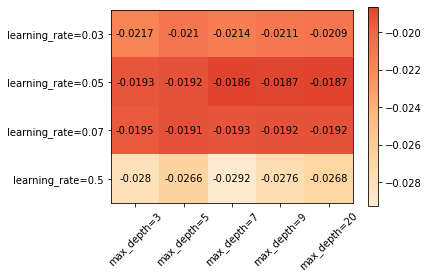

In [75]:
import sklearn_evaluation

sklearn_evaluation.plot.grid_search(search.cv_results_, change=('learning_rate', 'max_depth'), subset={ 'subsample': [1], 'alpha': [0] })

Podemos hacer esto de forma repetitiva para todos los valores de `subsample` y `alpha` y generar los graficos correspondientes:

> Nota: La funcion `np.meshgrid` genera todas las combinaciones posibles de los arreglos que uno le indica. En este caso se utiliza para generar todas las combinaciones posibles entre `subsample` y `alpha`.

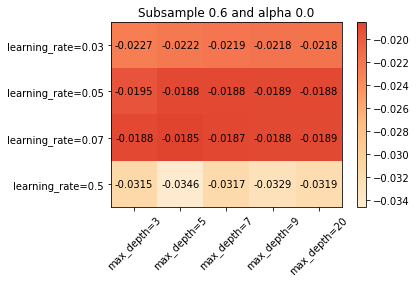

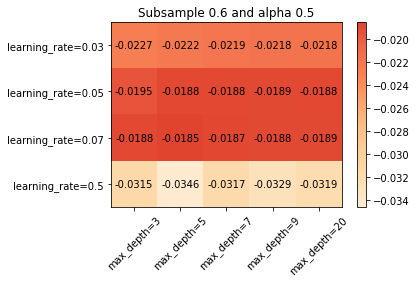

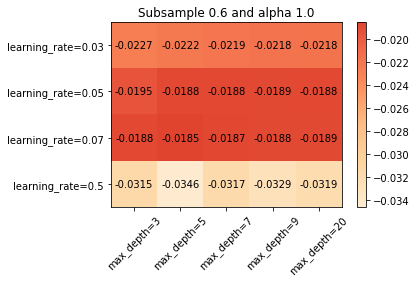

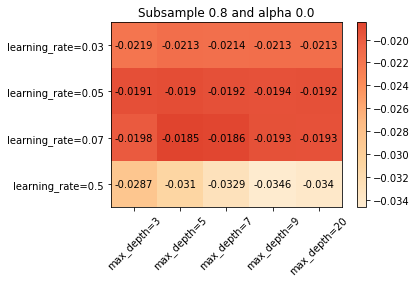

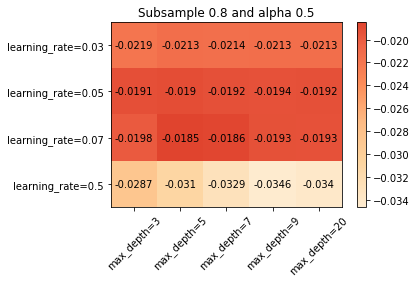

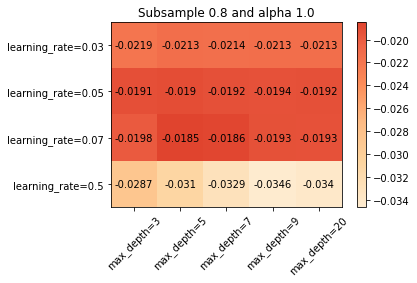

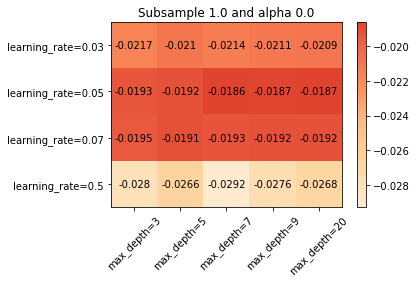

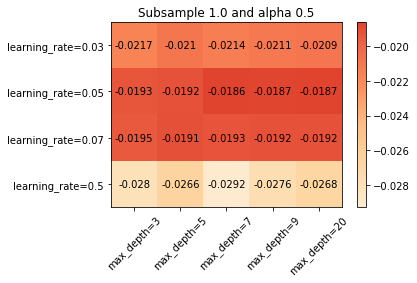

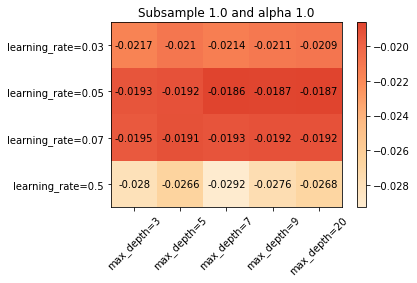

In [76]:
import numpy as np
import matplotlib.pyplot as plt

for subsample, alpha in np.array(np.meshgrid(parameters['subsample'], parameters['alpha'])).T.reshape(-1,2):
  fig = plt.figure()
  ax = fig.add_subplot()
  ax.set_title(f"Subsample {subsample} and alpha {alpha}")
  sklearn_evaluation.plot.grid_search(search.cv_results_, change=('learning_rate', 'max_depth'), subset={ 'subsample': [subsample], 'alpha': [alpha] }, ax=ax)
  ax.plot()

Para seleccionar el mejor modelo, simplemente utilizamos el metodo `best_estimator_`. Adicionalmente calcularemos sus metricas:

In [82]:
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error

print(search.best_params_)
print(f"MAE: {mean_absolute_error(predictions, y_test):.3f}")
print(f"MSE: {mean_squared_error(predictions, y_test):.3f}")
print(f"R2: {r2_score(predictions, y_test):.3f}")

{'alpha': 0, 'colsample_bytree': 0.7, 'learning_rate': 0.07, 'max_depth': 5, 'min_child_weight': 4, 'n_estimators': 200, 'subsample': 0.8}
MAE: 0.113
MSE: 0.021
R2: 0.901


In [83]:
model = search.best_estimator_

## Análisis de errores utilizando Error Analysis Dashboard

### A) Utilizando el modelo para analizar los errores

Para generar el análisis de errores, deberemos constuir un pipeline donde tengamos el preprocesamiento y el modelo propiamente dicho en un mismo objeto:

In [84]:
model_pipeline = Pipeline(steps=[('preprocessing', transformations),
                                 ('model', model)])

### B) Utilizando las predicciones para analizar los errores

Si entrenamos el modelo en otra herramienta, como ser Azure Machine Learning Studio, entonces podemos importar las predicciones al notebook para utilizarlas en lugar del modelo. Para demostrar como se realiza, en este caso utilizaremos las predicciones para analizar los errores, las cuales estan en `predictions`

In [53]:
predictions[:3]

array([9.7219  , 9.383067, 8.884694], dtype=float32)

### Ejecutando el análisis

Necesitamos indicar las variables que se utilizaran:

In [48]:
features = X_train.columns.values.tolist()
categorical_features = X_train.dtypes[X_train.dtypes == 'object'].index.tolist()

Abrimos la herramienta de análisis de errores

In [17]:
from raiwidgets import ErrorAnalysisDashboard

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.


In [52]:
from raiwidgets import ErrorAnalysisDashboard

ErrorAnalysisDashboard(dataset=X_test,
                       true_y=y_test,
                       categorical_features=categorical_features,
                       features=features,
                       pred_y=predictions,
                       model_task='regression')

ErrorAnalysis started at http://localhost:5002


Para ver el grafico en pantalla completa puede obtener la URL del grafico como sigue. Esto es opcional:

In [ ]:
from google.colab.output import eval_js
print(eval_js("google.colab.kernel.proxyPort(500)"))

https://3ecrugew5q4-496ff2e9c6d22116-5001-colab.googleusercontent.com/


## Análisis de errores utilizand fairlearn

Alternativamente, podemos utilizar la herramienta fairlearn para generar metricas por cada una de las variables que nos interesa analizar:

R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.
R^2 score is not well-defined with less than two samples.


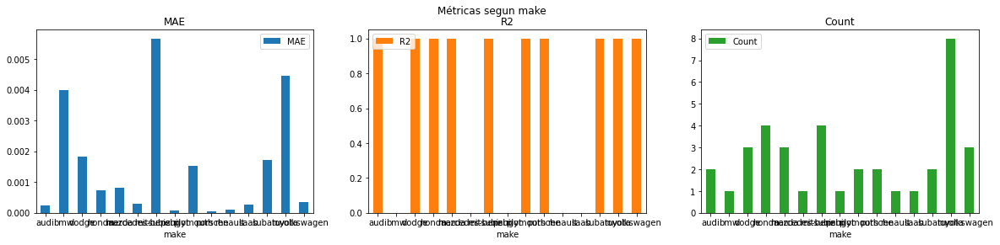

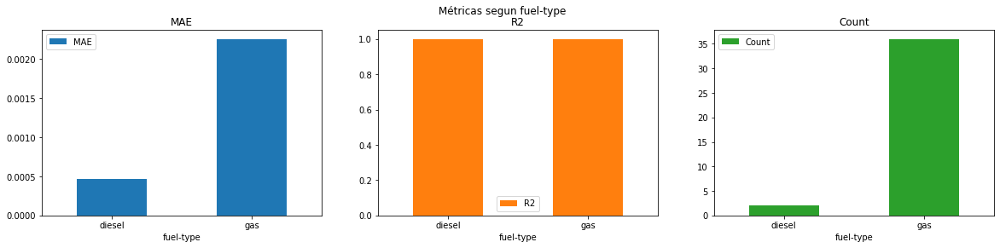

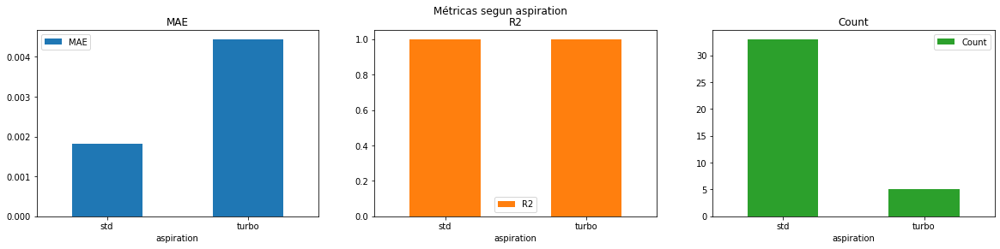

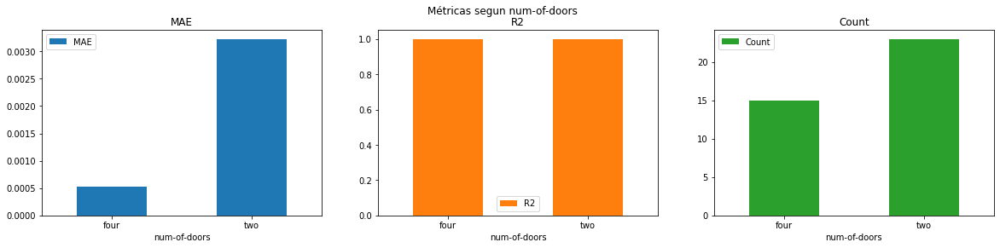

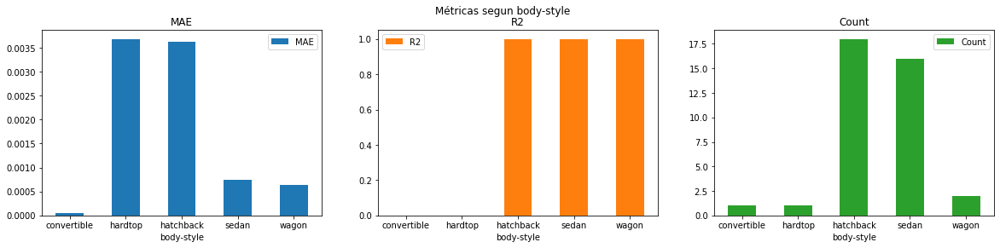

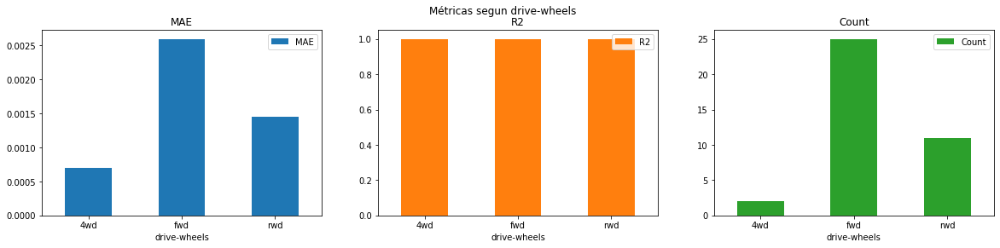

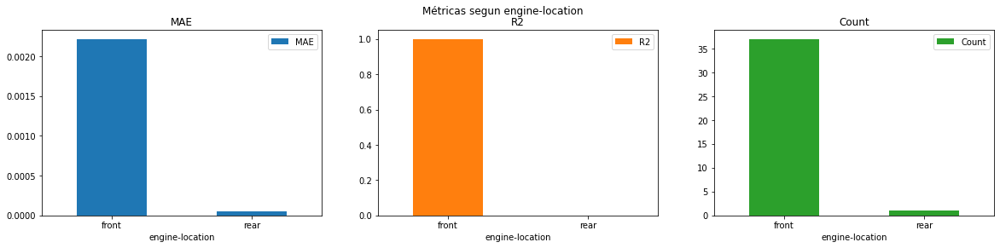

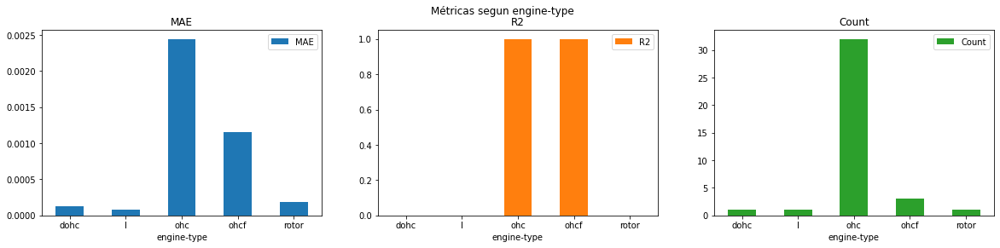

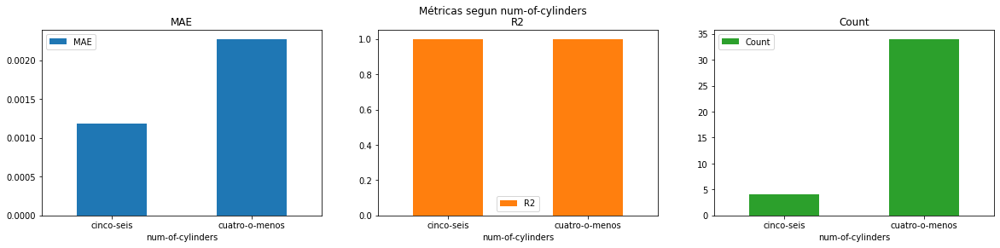

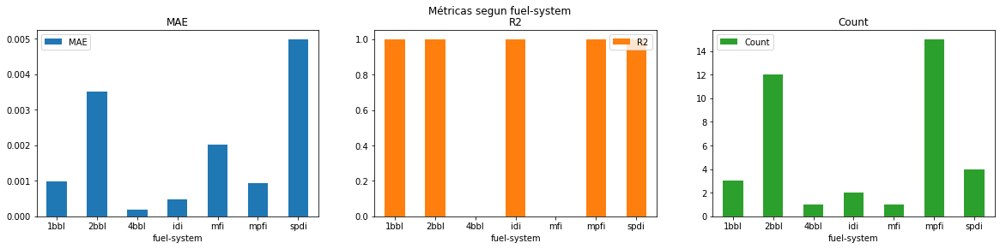

In [ ]:
from fairlearn.metrics import MetricFrame, count

mean_absolute_error, r2_score, mean_squared_error


for feature in categorical_features:
  selection_rates = MetricFrame(metrics={ 
                                  'MAE': mean_absolute_error,
                                  'R2': r2_score,
                                  'Count': count
                                },
                                y_true=y_train,
                                y_pred=intrain_predictions,
                                sensitive_features=X_train[feature])

  fig = selection_rates.by_group.plot.bar(
      subplots=True,
      layout=[1, 3],
      figsize=[20, 4],
      legend=True, rot=0,
      title=f'Métricas segun {feature}')

> Note como algunos agrupamientos tienen menos de 2 observaciones y por lo tanto la metrica R2 podría no ser de confianza.

Revisemos mas de cerca las mismas segun marca:

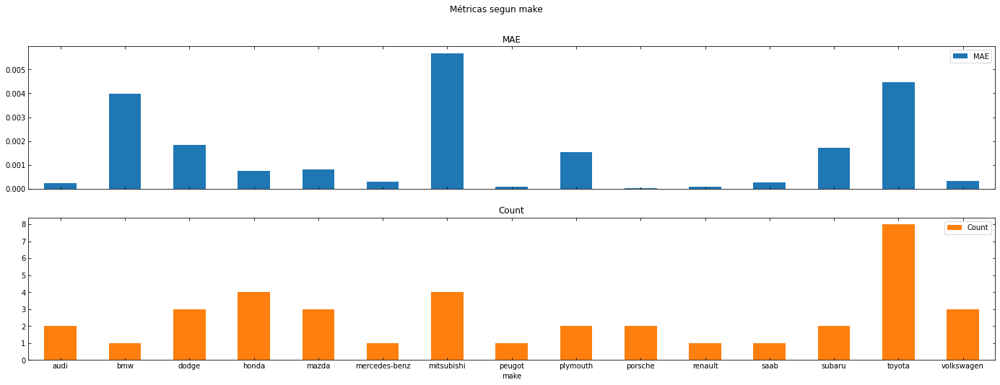

In [ ]:
import matplotlib.pyplot as plt

selection_rates = MetricFrame(metrics={ 
                                'MAE': mean_absolute_error,
                                'Count': count
                              },
                              y_true=y_train,
                              y_pred=intrain_predictions,
                              sensitive_features=X_train['make'])

fig = selection_rates.by_group.plot.bar(
    subplots=True,
    layout=[2, 1],
    figsize=[24, 8],
    legend=True, rot=0,
    title='Métricas segun make')